In [7]:
#Instalamos librería para análisis de variables categóricas
%pip install funpymodeling

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from funpymodeling.exploratory import freq_tbl

In [3]:
#Cargar archivo csv desde equipo
from google.colab import files
files.upload()

Saving Tokio_sin_outliers.csv to Tokio_sin_outliers.csv


{'Tokio_sin_outliers.csv': b',last_scraped,name,description,neighborhood_overview,host_location,host_response_time,host_is_superhost,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,property_type,room_type,bathrooms_text,amenities,price,has_availability,last_review,instant_bookable,Unnamed: 0,host_response_rate,host_acceptance_rate,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month\r\n0,2024-09-27,Oshiage Holiday Apartment,?,?,"Tokyo, Japan",within a day,t,"[\'email\',

In [4]:
#Carga desde un archivo .xlsx sin indice
df=pd.read_csv('Tokio_sin_outliers.csv')

In [5]:
#Verificamos la informacion del dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18736 entries, 0 to 18735
Data columns (total 53 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Unnamed: 0.1                 18736 non-null  int64  
 1   last_scraped                 18736 non-null  object 
 2   name                         18736 non-null  object 
 3   description                  18736 non-null  object 
 4   neighborhood_overview        18736 non-null  object 
 5   host_location                18736 non-null  object 
 6   host_response_time           18736 non-null  object 
 7   host_is_superhost            18736 non-null  object 
 8   host_verifications           18736 non-null  object 
 9   host_has_profile_pic         18736 non-null  object 
 10  host_identity_verified       18736 non-null  object 
 11  neighbourhood                18736 non-null  object 
 12  neighbourhood_cleansed       18736 non-null  object 
 13  property_type   

In [8]:
#Imprimo los primeros 5 registros del Dataframe
df.head()

,Unnamed: 0.1,last_scraped,name,description,neighborhood_overview,host_location,host_response_time,host_is_superhost,host_verifications,host_has_profile_pic,...,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,0,2024-09-27,Oshiage Holiday Apartment,?,?,"Tokyo, Japan",within a day,t,"['email', 'phone']",t,...,22.3,7.0,1.0,4.78,4.91,4.84,4.83,4.55,4.80,1.14
1,1,2024-09-27,Kero-kero house room 1,We have been in airbnb since 2011 and it has g...,We love Nishinippori because is nearer to Toky...,Japan,within an hour,t,"['email', 'phone']",t,...,22.3,10.0,2.0,4.98,4.91,4.98,4.98,4.84,4.92,1.79
2,2,2024-09-27,4F Spacious Apartment in Shinjuku / Shibuya Tokyo,NEWLY RENOVATED property entirely for you & yo...,Hatagaya is a great neighborhood located 4 min...,"Tokyo, Japan",within an hour,t,"['email', 'phone']",t,...,22.3,35.0,3.0,4.80,4.80,4.88,4.92,4.80,4.80,1.65
3,3,2024-09-27,5 mins Shibuya Cat modern sunny Shimokita,"Hi there, I am Wakana and I live with my two f...",The location is walkable distance to famous Sh...,"Tokyo, Japan",within a few hours,t,"['email', 'phone']",t,...,22.3,11.0,0.0,4.95,4.84,4.94,4.98,4.92,4.90,1.92
4,4,2024-09-27,Stay with host Cozy private room Senju area,Ｓtay with host.We can help your travel.<br />B...,There are shopping mall near Senjuohashi stati...,"Tokyo, Japan",within an hour,t,"['email', 'phone']",t,...,22.3,26.0,2.0,4.78,4.79,4.94,4.91,4.73,4.81,0.92


In [10]:
freq_tbl(df)

  last_scraped  frequency  percentage  cumulative_perc
0   2024-09-27      18736         1.0              1.0

----------------------------------------------------------------

                                                    name  frequency  \
0         Shinjyuku, JR Shin-Okubo Sta. 6mins. Free wifi         50   
1      Shinjuku Double Bed Room/Perfect Access Okubo2min         35   
2       NICE LOCATION NEAR GINZA and TSUKIJI fish market         32   
3            Shinjuku Warm House 2 bedrooms *English OK*         31   
4      Shinjyuku・Nishi-shinjyuku 5 Chome Sta. 5min. Wifi         24   
...                                                  ...        ...   
16801  上野桜見へ電車９分、浅草、皇居，秋葉原銀座直通．１DK、家族・ビジネスに最適。伝統的な和風の一軒家          1   
16802     3 beds good access private bathroom and toilet          1   
16803    2 beds, good access private bathroom and toilet          1   
16804  Cozy Inn Tokyo Sakura-shinmachi［Room F］single ...          1   
16805                           池袋エリア/駅5分/

In [14]:
df['host_response_rate'] = df['host_response_rate'].astype('category')

In [15]:
table= freq_tbl(df['host_response_rate'])
table

,host_response_rate,frequency,percentage,cumulative_perc
0,100.0,18736,1.0,1.0


In [16]:
#Elimina las columnas "percentage" y "cumulative_perc"
tables= table.drop(['percentage','cumulative_perc'], axis=1)
tables

,host_response_rate,frequency
0,100.0,18736


In [17]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
tables= tables[tables['frequency']>100]
tables

,host_response_rate,frequency
0,100.0,18736


In [18]:
#Ajusto el indice de mi dataframe
tables= tables.set_index('host_response_rate')
tables

,frequency
host_response_rate,
100.0,18736


<Axes: ylabel='frequency'>

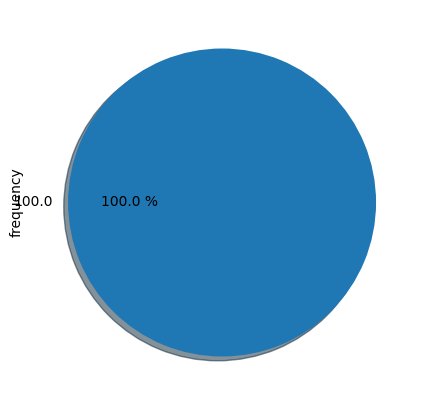

In [19]:
#Realizamos grafico de pastel
tables["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [21]:
df['host_acceptance_rate'] = df['host_acceptance_rate'].astype('category')

In [22]:
table1= freq_tbl(df['host_acceptance_rate'])
table1

,host_acceptance_rate,frequency,percentage,cumulative_perc
0,100.0,10452,0.557857,0.557857
1,99.0,2570,0.137169,0.695026
2,99.2,1994,0.106426,0.801452
3,98.0,1520,0.081127,0.882579
4,97.0,1187,0.063354,0.945933
5,96.0,564,0.030102,0.976035
6,95.0,449,0.023965,1.000000


In [23]:
#Elimina las columnas "percentage" y "cumulative_perc"
table1= table1.drop(['percentage','cumulative_perc'], axis=1)
table1

,host_acceptance_rate,frequency
0,100.0,10452
1,99.0,2570
2,99.2,1994
3,98.0,1520
4,97.0,1187
5,96.0,564
6,95.0,449


In [24]:
#Ajusto el indice de mi dataframe
table1= table1.set_index('host_acceptance_rate')
table1

,frequency
host_acceptance_rate,
100.0,10452
99.0,2570
99.2,1994
98.0,1520
97.0,1187
96.0,564
95.0,449


In [25]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table1= table1[table1['frequency']>350]
table1

,frequency
host_acceptance_rate,
100.0,10452
99.0,2570
99.2,1994
98.0,1520
97.0,1187
96.0,564
95.0,449


Text(0, 0.5, 'Frecuencia')

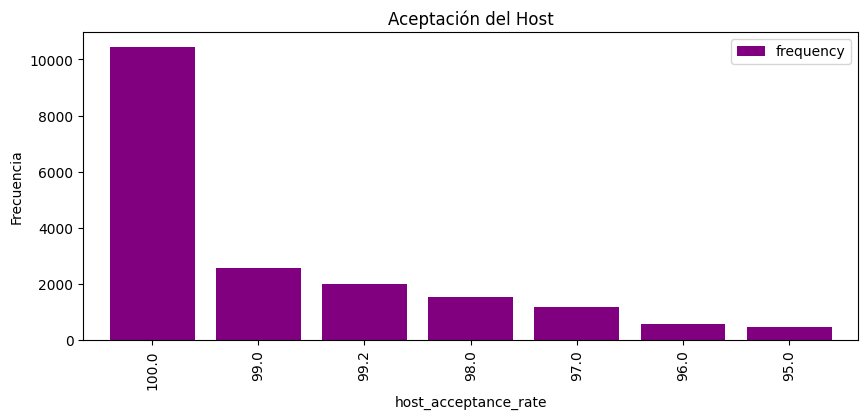

In [26]:
#Personalizamos grafico de barras
table1.plot(kind= 'bar', width=0.8, figsize=(10,4), color="purple")
plt.title('Aceptación del Host')
plt.xlabel('host_acceptance_rate')
plt.ylabel('Frecuencia')

In [27]:
table2= freq_tbl(df['host_is_superhost'])
table2

,host_is_superhost,frequency,percentage,cumulative_perc
0,f,10401,0.555135,0.555135
1,t,6919,0.369289,0.924424
2,?,1416,0.075576,1.000000


In [28]:
#Elimina las columnas "percentage" y "cumulative_perc"
table2= table2.drop(['percentage','cumulative_perc'], axis=1)
table2

,host_is_superhost,frequency
0,f,10401
1,t,6919
2,?,1416


In [29]:
#Ajusto el indice de mi dataframe
table2= table2.set_index('host_is_superhost')
table2

,frequency
host_is_superhost,
f,10401
t,6919
?,1416


<Axes: ylabel='frequency'>

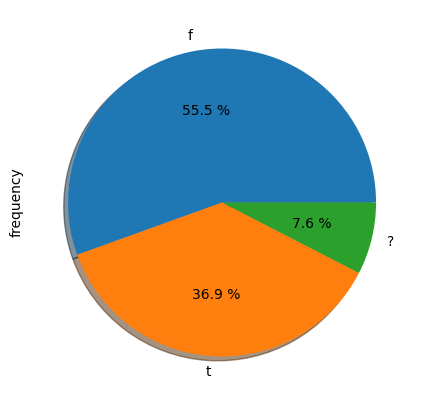

In [30]:
#Realizamos grafico de pastel
table2["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [31]:
table3= freq_tbl(df['host_verifications'])
table3

,host_verifications,frequency,percentage,cumulative_perc
0,"['email', 'phone']",15659,0.835771,0.835771
1,['phone'],2090,0.111550,0.947321
2,"['email', 'phone', 'work_email']",861,0.045954,0.993275
3,"['phone', 'work_email']",108,0.005764,0.999039
4,['email'],16,0.000854,0.999893
5,[],2,0.000107,1.000000


<Axes: xlabel='frequency', ylabel='cumulative_perc'>

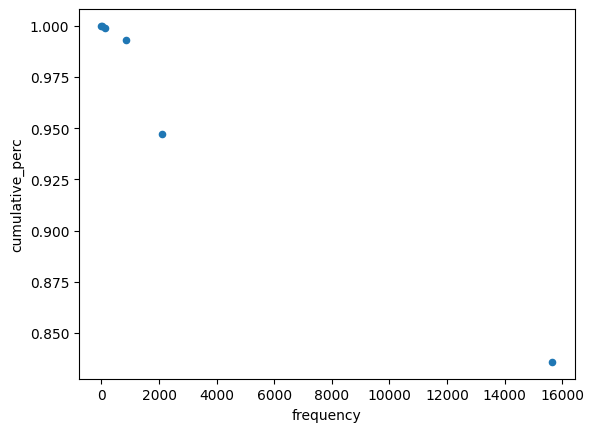

In [32]:
#Realizamos grafico de dispersion del dataframe filtrado
table3.plot("frequency", "cumulative_perc", kind="scatter")

In [33]:
table4= freq_tbl(df['host_identity_verified'])
table4

,host_identity_verified,frequency,percentage,cumulative_perc
0,t,18164,0.969471,0.969471
1,f,572,0.030529,1.000000


In [34]:
#Elimina las columnas "percentage" y "cumulative_perc"
table4= table4.drop(['percentage','cumulative_perc'], axis=1)
table4

,host_identity_verified,frequency
0,t,18164
1,f,572


In [35]:
#Ajusto el indice de mi dataframe
table4= table4.set_index('host_identity_verified')
table4

,frequency
host_identity_verified,
t,18164
f,572


<Axes: ylabel='frequency'>

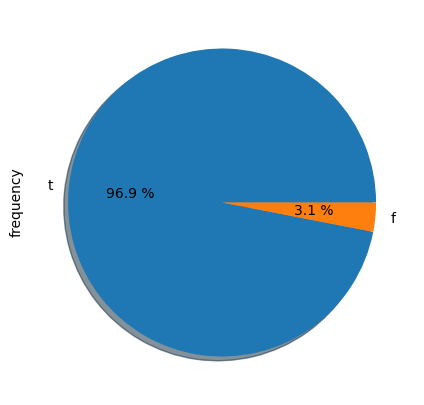

In [36]:
#Realizamos grafico de pastel
table4["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [37]:
table5= freq_tbl(df['neighbourhood'])
table5

,neighbourhood,frequency,percentage,cumulative_perc
0,?,7054,0.376494,0.376494
1,"Shinjuku City, Tokyo, Japan",1562,0.083369,0.459863
2,"Sumida City, Tokyo, Japan",1143,0.061006,0.520869
3,"Taito City, Tokyo, Japan",698,0.037254,0.558123
4,"Toshima City, Tokyo, Japan",657,0.035066,0.593190
...,...,...,...,...
387,"Minato-ku, Tokyo-to, Japan",1,0.000053,0.999787
388,"Minato-ku , Tōkyō-to, Japan",1,0.000053,0.999840
389,"shinjuku city, Tōkyō, Japan",1,0.000053,0.999893
390,"Suginami-ku, Tō, Japan",1,0.000053,0.999947


In [38]:
#Elimina las columnas "percentage" y "cumulative_perc"
table5= table5.drop(['percentage','cumulative_perc'], axis=1)
table5

,neighbourhood,frequency
0,?,7054
1,"Shinjuku City, Tokyo, Japan",1562
2,"Sumida City, Tokyo, Japan",1143
3,"Taito City, Tokyo, Japan",698
4,"Toshima City, Tokyo, Japan",657
...,...,...
387,"Minato-ku, Tokyo-to, Japan",1
388,"Minato-ku , Tōkyō-to, Japan",1
389,"shinjuku city, Tōkyō, Japan",1
390,"Suginami-ku, Tō, Japan",1


In [39]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table5= table5[table5['frequency']>14]
table5

,neighbourhood,frequency
0,?,7054
1,"Shinjuku City, Tokyo, Japan",1562
2,"Sumida City, Tokyo, Japan",1143
3,"Taito City, Tokyo, Japan",698
4,"Toshima City, Tokyo, Japan",657
...,...,...
88,"Mitaka, Tokyo, Japan",16
89,"Itabashi City, Tōkyō-to, Japan",16
90,"Shinjuku-Ku, Tokyo, Japan",15
91,"中野区, 東京都, Japan",15


In [40]:
#Ajusto el indice de mi dataframe
table5= table5.set_index('neighbourhood')
table5

,frequency
neighbourhood,
?,7054
"Shinjuku City, Tokyo, Japan",1562
"Sumida City, Tokyo, Japan",1143
"Taito City, Tokyo, Japan",698
"Toshima City, Tokyo, Japan",657
...,...
"Mitaka, Tokyo, Japan",16
"Itabashi City, Tōkyō-to, Japan",16
"Shinjuku-Ku, Tokyo, Japan",15


Text(0, 0.5, 'Frecuencia')

/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 23487 (\N{CJK UNIFIED IDEOGRAPH-5BBF}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 21306 (\N{CJK UNIFIED IDEOGRAPH-533A}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 26481 (\N{CJK UNIFIED IDEOGRAPH-6771}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 20140 (\N{CJK UNIFIED IDEOGRAPH-4EAC}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph

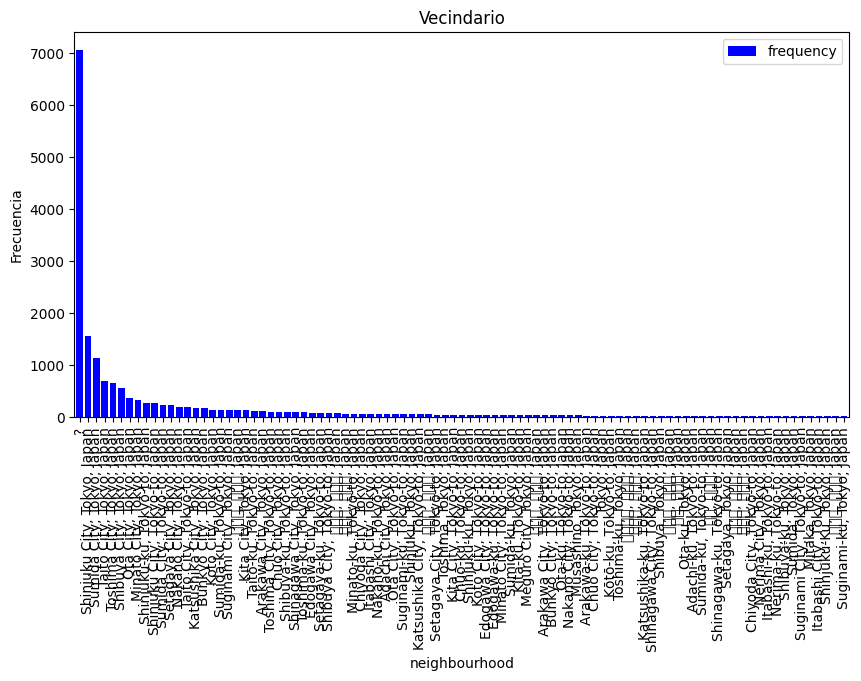

In [41]:
#Personalizamos grafico de barras
table5.plot(kind= 'bar', width=0.8, figsize=(10,5), color="blue")
plt.title('Vecindario')
plt.xlabel('neighbourhood')
plt.ylabel('Frecuencia')

In [42]:
table6= freq_tbl(df['neighbourhood_cleansed'])
table6

,neighbourhood_cleansed,frequency,percentage,cumulative_perc
0,Shinjuku Ku,3701,0.197534,0.197534
1,Sumida Ku,2451,0.130818,0.328352
2,Taito Ku,2120,0.113151,0.441503
3,Toshima Ku,1775,0.094737,0.536240
4,Shibuya Ku,1208,0.064475,0.600715
5,Ota Ku,758,0.040457,0.641172
6,Minato Ku,699,0.037308,0.678480
7,Setagaya Ku,608,0.032451,0.710931
8,Nakano Ku,561,0.029942,0.740873
9,Kita Ku,547,0.029195,0.770068


<Axes: xlabel='frequency', ylabel='cumulative_perc'>

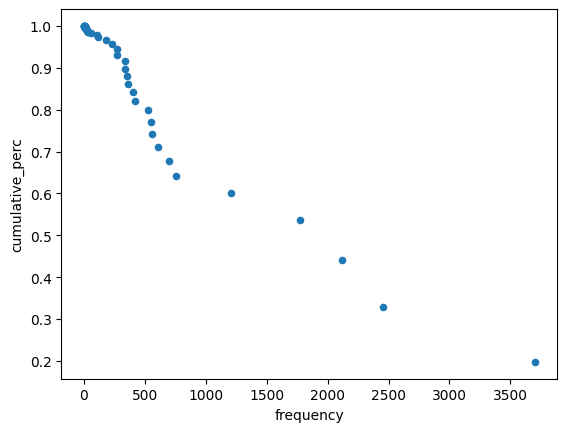

In [43]:
#Realizamos grafico de dispersion del dataframe filtrado
table6.plot("frequency", "cumulative_perc", kind="scatter")

In [44]:
table7= freq_tbl(df['property_type'])
table7

,property_type,frequency,percentage,cumulative_perc
0,Entire rental unit,11288,0.602477,0.602477
1,Entire home,2382,0.127135,0.729611
2,Room in hotel,882,0.047075,0.776687
3,Private room in home,730,0.038962,0.815649
4,Private room in rental unit,684,0.036507,0.852156
...,...,...,...,...
59,Private room in barn,1,0.000053,0.999787
60,Entire bungalow,1,0.000053,0.999840
61,Treehouse,1,0.000053,0.999893
62,Private room in camper/rv,1,0.000053,0.999947


In [45]:
#Elimina las columnas "percentage" y "cumulative_perc"
table7= table7.drop(['percentage','cumulative_perc'], axis=1)
table7

,property_type,frequency
0,Entire rental unit,11288
1,Entire home,2382
2,Room in hotel,882
3,Private room in home,730
4,Private room in rental unit,684
...,...,...
59,Private room in barn,1
60,Entire bungalow,1
61,Treehouse,1
62,Private room in camper/rv,1


In [46]:
#Ajusto el indice de mi dataframe
table7= table7.set_index('property_type')
table7

,frequency
property_type,
Entire rental unit,11288
Entire home,2382
Room in hotel,882
Private room in home,730
Private room in rental unit,684
...,...
Private room in barn,1
Entire bungalow,1
Treehouse,1


In [47]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table7= table7[table7['frequency']>231]
table7

,frequency
property_type,
Entire rental unit,11288
Entire home,2382
Room in hotel,882
Private room in home,730
Private room in rental unit,684
Entire condo,524
Room in aparthotel,335
Entire serviced apartment,323
Room in boutique hotel,237


<Axes: ylabel='frequency'>

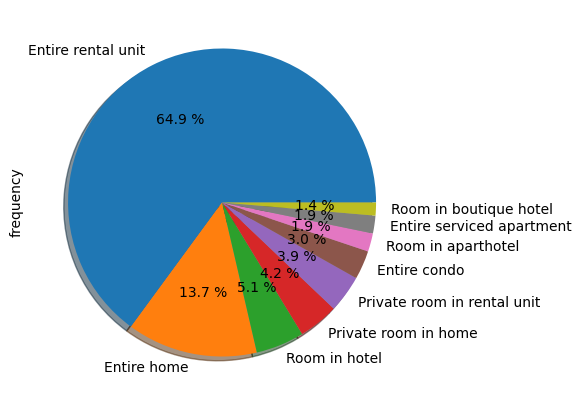

In [48]:
#Realizamos grafico de pastel
table7["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [49]:
table8= freq_tbl(df['room_type'])
table8

,room_type,frequency,percentage,cumulative_perc
0,Entire home/apt,15109,0.806415,0.806415
1,Private room,3058,0.163215,0.969631
2,Shared room,424,0.022630,0.992261
3,Hotel room,145,0.007739,1.000000


In [51]:
#Elimina las columnas "percentage" y "cumulative_perc"
table8= table8.drop(['percentage','cumulative_perc'], axis=1)
table8

,room_type,frequency
0,Entire home/apt,15109
1,Private room,3058
2,Shared room,424
3,Hotel room,145


In [52]:
#Ajusto el indice de mi dataframe
table8= table8.set_index('room_type')
table8

,frequency
room_type,
Entire home/apt,15109
Private room,3058
Shared room,424
Hotel room,145


Text(0, 0.5, 'Frecuencia')

/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 26032 (\N{CJK UNIFIED IDEOGRAPH-65B0}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 23487 (\N{CJK UNIFIED IDEOGRAPH-5BBF}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 21306 (\N{CJK UNIFIED IDEOGRAPH-533A}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 26481 (\N{CJK UNIFIED IDEOGRAPH-6771}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph 20140 (\N{CJK UNIFIED IDEOGRAPH-4EAC}) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
/usr/local/lib/python3.11/dist-packages/IPython/core/events.py:89: UserWarning: Glyph

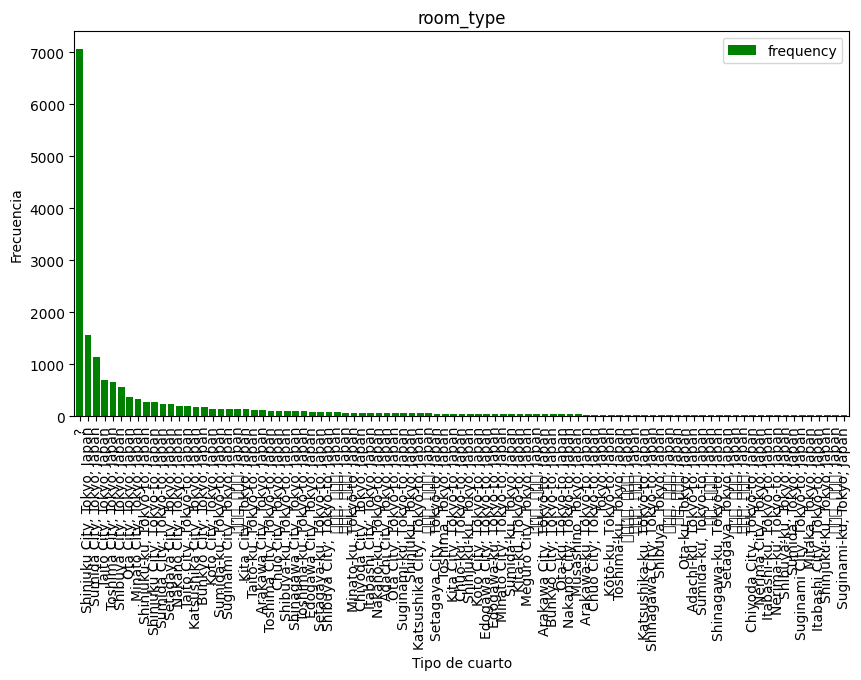

In [53]:
#Personalizamos grafico de barras
table5.plot(kind= 'bar', width=0.8, figsize=(10,5), color="GREEN")
plt.title('room_type')
plt.xlabel('Tipo de cuarto')
plt.ylabel('Frecuencia')

In [54]:
table9= freq_tbl(df['amenities'])
table9

,amenities,frequency,percentage,cumulative_perc
0,"[""Essentials"", ""Bed linens"", ""Carbon monoxide ...",82,0.004377,0.004377
1,"[""Essentials"", ""Bed linens"", ""Rice maker"", ""Ga...",79,0.004216,0.008593
2,"[""Essentials"", ""Bed linens"", ""Rice maker"", ""Se...",59,0.003149,0.011742
3,"[""Essentials"", ""Bed linens"", ""Rice maker"", ""Se...",52,0.002775,0.014518
4,"[""Essentials"", ""Bed linens"", ""Self check-in"", ...",42,0.002242,0.016759
...,...,...,...,...
14622,"[""Essentials"", ""Bed linens"", ""Gas stove"", ""Coo...",1,0.000053,0.999787
14623,"[""Essentials"", ""Keypad"", ""Bed linens"", ""Rice m...",1,0.000053,0.999840
14624,"[""Essentials"", ""Keypad"", ""Bed linens"", ""Rice m...",1,0.000053,0.999893
14625,"[""TV with standard cable"", ""Essentials"", ""Keyp...",1,0.000053,0.999947


<Axes: xlabel='frequency', ylabel='cumulative_perc'>

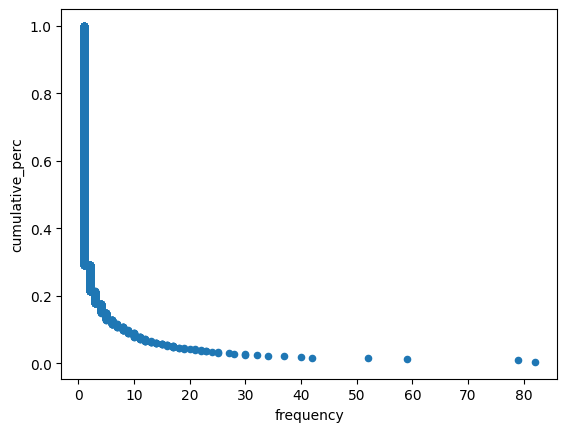

In [56]:
#Realizamos grafico de dispersion del dataframe filtrado
table9.plot("frequency", "cumulative_perc", kind="scatter")

In [57]:
table10= freq_tbl(df['price'])
table10

,price,frequency,percentage,cumulative_perc
0,?,1832,0.097780,0.097780
1,"$20,000.00",148,0.007899,0.105679
2,"$7,560.00",144,0.007686,0.113365
3,"$10,000.00",137,0.007312,0.120677
4,"$15,000.00",134,0.007152,0.127829
...,...,...,...,...
5428,"$59,800.00",1,0.000053,0.999787
5429,"$21,514.00",1,0.000053,0.999840
5430,"$59,296.00",1,0.000053,0.999893
5431,"$27,717.00",1,0.000053,0.999947


In [58]:
#Elimina las columnas "percentage" y "cumulative_perc"
table10= table10.drop(['percentage','cumulative_perc'], axis=1)
table10

,price,frequency
0,?,1832
1,"$20,000.00",148
2,"$7,560.00",144
3,"$10,000.00",137
4,"$15,000.00",134
...,...,...
5428,"$59,800.00",1
5429,"$21,514.00",1
5430,"$59,296.00",1
5431,"$27,717.00",1


In [59]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table10= table10[table10['frequency']>131]
table10

,price,frequency
0,?,1832
1,"$20,000.00",148
2,"$7,560.00",144
3,"$10,000.00",137
4,"$15,000.00",134


In [60]:
#Ajusto el indice de mi dataframe
table10= table10.set_index('price')
table10

,frequency
price,
?,1832
"$20,000.00",148
"$7,560.00",144
"$10,000.00",137
"$15,000.00",134


<Axes: ylabel='frequency'>

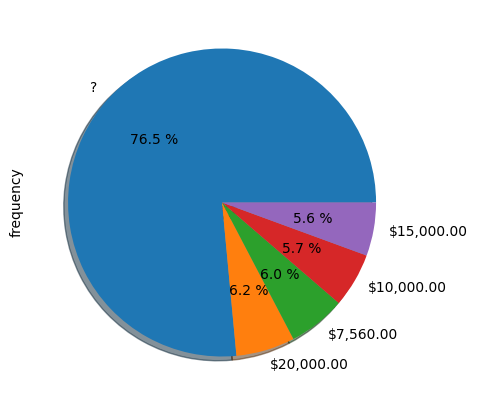

In [61]:
#Realizamos grafico de pastel
table10["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [62]:
table11= freq_tbl(df['has_availability'])
table11

,has_availability,frequency,percentage,cumulative_perc
0,t,18623,0.993969,0.993969
1,?,104,0.005551,0.999520
2,f,9,0.000480,1.000000


In [63]:
#Elimina las columnas "percentage" y "cumulative_perc"
table11= table11.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table11= table11.set_index('has_availability')
table11

,frequency
has_availability,
t,18623
?,104
f,9


Text(0, 0.5, 'Frecuencia')

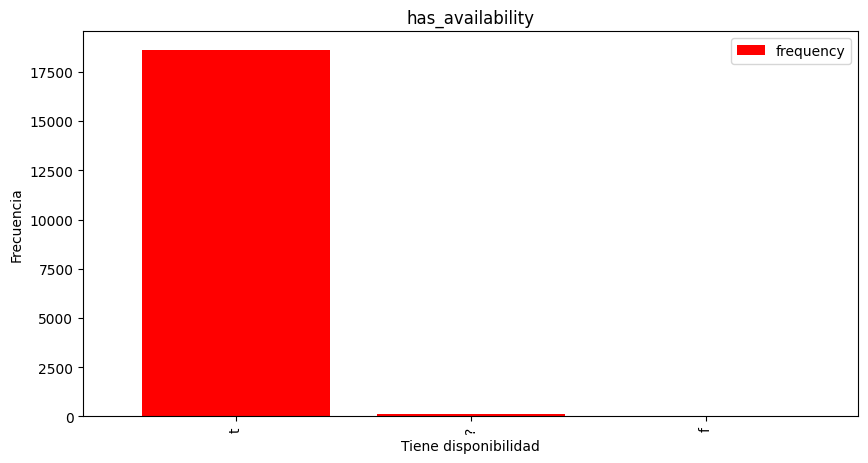

In [64]:
#Personalizamos grafico de barras
table11.plot(kind= 'bar', width=0.8, figsize=(10,5), color="red")
plt.title('has_availability')
plt.xlabel('Tiene disponibilidad')
plt.ylabel('Frecuencia')

In [65]:
table12= freq_tbl(df['last_review'])
table12

,last_review,frequency,percentage,cumulative_perc
0,?,2405,0.128363,0.128363
1,2024-09-23,693,0.036988,0.165350
2,2024-09-22,603,0.032184,0.197534
3,2024-09-16,535,0.028555,0.226089
4,2024-09-24,475,0.025352,0.251441
...,...,...,...,...
848,2022-01-07,1,0.000053,0.999787
849,2022-12-08,1,0.000053,0.999840
850,2021-07-18,1,0.000053,0.999893
851,2022-08-27,1,0.000053,0.999947


In [66]:
#Elimina las columnas "percentage" y "cumulative_perc"
table12= table12.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table12= table12.set_index('last_review')
table12

,frequency
last_review,
?,2405
2024-09-23,693
2024-09-22,603
2024-09-16,535
2024-09-24,475
...,...
2022-01-07,1
2022-12-08,1
2021-07-18,1


In [67]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table12= table12[table12['frequency']>184]
table12

,frequency
last_review,
?,2405
2024-09-23,693
2024-09-22,603
2024-09-16,535
2024-09-24,475
2024-09-17,419
2024-09-18,399
2024-09-08,396
2024-09-15,393


<Axes: ylabel='frequency'>

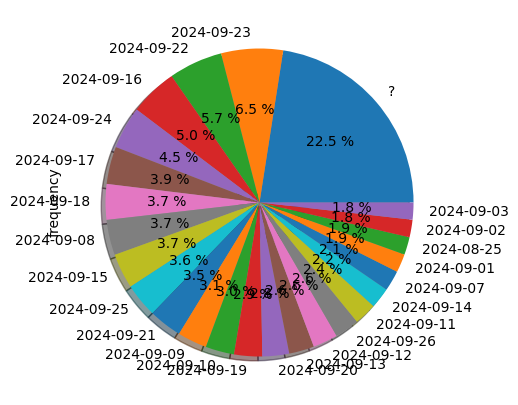

In [68]:
#Realizamos grafico de pastel
table12["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [73]:
df['review_scores_rating'] = df['review_scores_rating'].astype('category')

In [74]:
table13= freq_tbl(df['review_scores_rating'])
table13

,review_scores_rating,frequency,percentage,cumulative_perc
0,5.00,5255,0.280476,0.280476
1,4.80,1151,0.061433,0.341909
2,4.67,496,0.026473,0.368382
3,4.50,484,0.025833,0.394214
4,4.83,386,0.020602,0.414816
...,...,...,...,...
90,4.09,10,0.000534,0.998666
91,4.07,8,0.000427,0.999093
92,4.06,7,0.000374,0.999466
93,4.12,6,0.000320,0.999787


In [75]:
#Elimina las columnas "percentage" y "cumulative_perc"
table13= table13.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table13= table13.set_index('review_scores_rating')
table13

,frequency
review_scores_rating,
5.00,5255
4.80,1151
4.67,496
4.50,484
4.83,386
...,...
4.09,10
4.07,8
4.06,7


In [76]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table13= table13[table13['frequency']>217]
table13

,frequency
review_scores_rating,
5.00,5255
4.80,1151
4.67,496
4.50,484
4.83,386
4.75,384
4.88,360
4.86,347
4.71,315


Text(0, 0.5, 'Frecuencia')

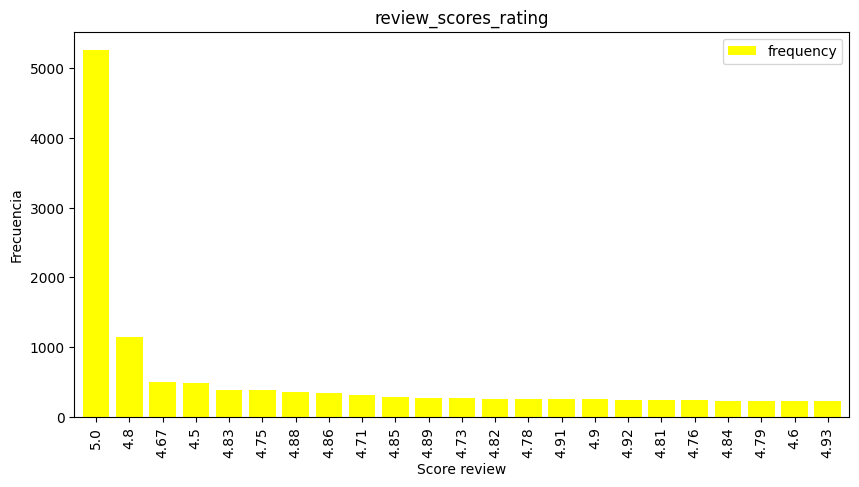

In [77]:
#Personalizamos grafico de barras
table13.plot(kind= 'bar', width=0.8, figsize=(10,5), color="yellow")
plt.title('review_scores_rating')
plt.xlabel('Score review')
plt.ylabel('Frecuencia')

In [79]:
df['review_scores_cleanliness'] = df['review_scores_cleanliness'].astype('category')

In [80]:
table14= freq_tbl(df['review_scores_cleanliness'])
table14

,review_scores_cleanliness,frequency,percentage,cumulative_perc
0,5.00,5385,0.287415,0.287415
1,4.80,960,0.051238,0.338653
2,4.50,470,0.025085,0.363738
3,4.67,437,0.023324,0.387062
4,4.75,374,0.019962,0.407024
...,...,...,...,...
95,4.05,11,0.000587,0.998559
96,4.12,9,0.000480,0.999039
97,4.04,8,0.000427,0.999466
98,4.03,7,0.000374,0.999840


<Axes: xlabel='frequency', ylabel='cumulative_perc'>

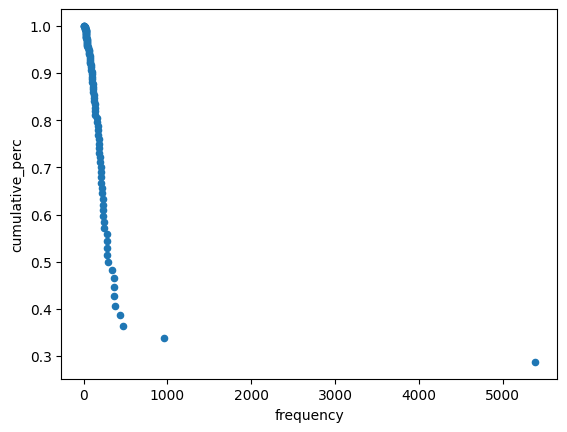

In [81]:
#Realizamos grafico de dispersion del dataframe filtrado
table14.plot("frequency", "cumulative_perc", kind="scatter")

In [84]:
df['review_scores_value'] = df['review_scores_value'].astype('category')

In [85]:
table15= freq_tbl(df['review_scores_value'])
table15

,review_scores_value,frequency,percentage,cumulative_perc
0,5.00,4622,0.246691,0.246691
1,4.70,696,0.037148,0.283839
2,4.50,618,0.032985,0.316823
3,4.67,591,0.031544,0.348367
4,4.75,462,0.024658,0.373025
...,...,...,...,...
97,4.99,1,0.000053,0.999787
98,4.02,1,0.000053,0.999840
99,4.03,1,0.000053,0.999893
100,3.97,1,0.000053,0.999947


In [86]:
#Elimina las columnas "percentage" y "cumulative_perc"
table15= table15.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table15= table15.set_index('review_scores_value')
table15

,frequency
review_scores_value,
5.00,4622
4.70,696
4.50,618
4.67,591
4.75,462
...,...
4.99,1
4.02,1
4.03,1


In [87]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table15= table15[table15['frequency']>315]
table15

,frequency
review_scores_value,
5.00,4622
4.70,696
4.50,618
4.67,591
4.75,462
4.00,445
4.80,361
4.71,350
4.83,336


<Axes: ylabel='frequency'>

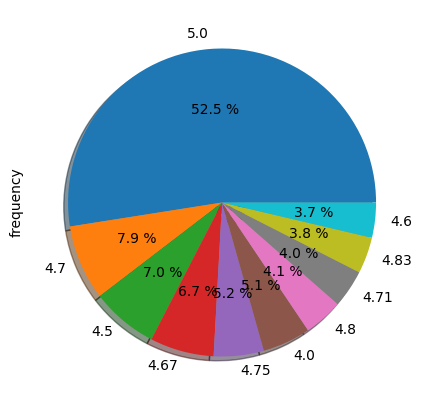

In [88]:
#Realizamos grafico de pastel
table15["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [89]:
table16= freq_tbl(df['instant_bookable'])
table16

,instant_bookable,frequency,percentage,cumulative_perc
0,t,13900,0.741887,0.741887
1,f,4836,0.258113,1.000000


In [90]:
#Elimina las columnas "percentage" y "cumulative_perc"
table16= table16.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table16= table16.set_index('instant_bookable')
table16

,frequency
instant_bookable,
t,13900
f,4836


Text(0, 0.5, 'Frecuencia')

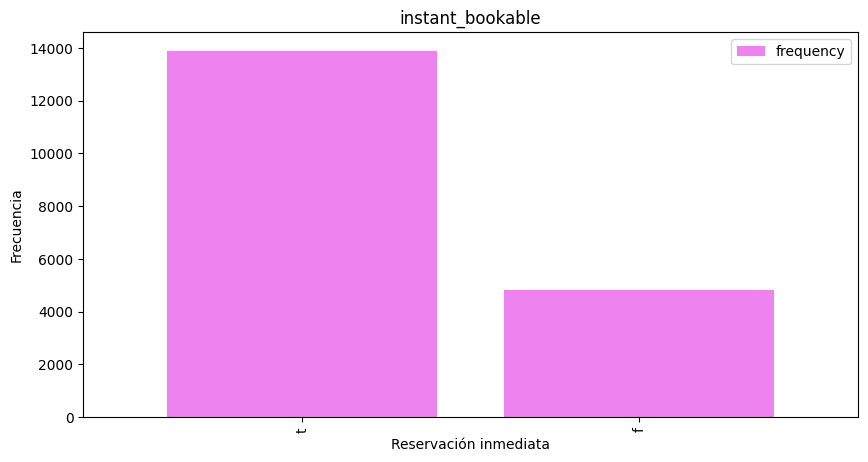

In [91]:
#Personalizamos grafico de barras
table16.plot(kind= 'bar', width=0.8, figsize=(10,5), color="violet")
plt.title('instant_bookable')
plt.xlabel('Reservación inmediata')
plt.ylabel('Frecuencia')

In [93]:
df['reviews_per_month'] = df['reviews_per_month'].astype('category')

In [94]:
table17= freq_tbl(df['reviews_per_month'])
table17

,reviews_per_month,frequency,percentage,cumulative_perc
0,1.00,2809,0.149925,0.149925
1,1.40,841,0.044887,0.194812
2,2.00,179,0.009554,0.204366
3,3.00,114,0.006085,0.210450
4,0.78,80,0.004270,0.214720
...,...,...,...,...
404,3.74,5,0.000267,0.999199
405,3.92,4,0.000213,0.999413
406,3.86,4,0.000213,0.999626
407,0.01,4,0.000213,0.999840


In [95]:
#Elimina las columnas "percentage" y "cumulative_perc"
table17= table17.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table17= table17.set_index('reviews_per_month')
table17

,frequency
reviews_per_month,
1.00,2809
1.40,841
2.00,179
3.00,114
0.78,80
...,...
3.74,5
3.92,4
3.86,4


In [96]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table17= table17[table17['frequency']>139]
table17

,frequency
reviews_per_month,
1.0,2809
1.4,841
2.0,179


<Axes: ylabel='frequency'>

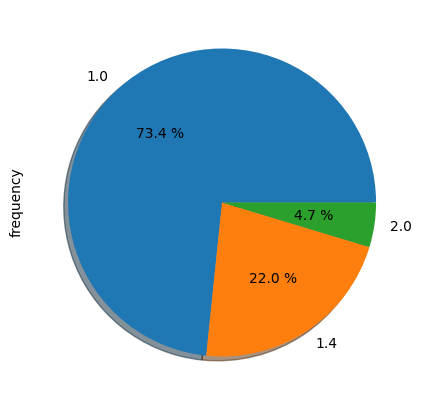

In [97]:
#Realizamos grafico de pastel
table17["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [98]:
table18= freq_tbl(df['host_location'])
table18

,host_location,frequency,percentage,cumulative_perc
0,"Tokyo, Japan",6363,0.339614,0.339614
1,?,5429,0.289763,0.629377
2,"Shinjuku City, Japan",764,0.040777,0.670154
3,"Minato City, Japan",631,0.033678,0.703832
4,"Taito City, Japan",532,0.028395,0.732227
...,...,...,...,...
171,"Aomori, Japan",1,0.000053,0.999787
172,"Ibaraki, Japan",1,0.000053,0.999840
173,"Shizuoka, Japan",1,0.000053,0.999893
174,"Tsukuba, Japan",1,0.000053,0.999947


In [99]:
#Elimina las columnas "percentage" y "cumulative_perc"
table18= table18.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table18= table18.set_index('host_location')
table18

,frequency
host_location,
"Tokyo, Japan",6363
?,5429
"Shinjuku City, Japan",764
"Minato City, Japan",631
"Taito City, Japan",532
...,...
"Aomori, Japan",1
"Ibaraki, Japan",1
"Shizuoka, Japan",1


In [100]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table18= table18[table18['frequency']>17]
table18

,frequency
host_location,
"Tokyo, Japan",6363
?,5429
"Shinjuku City, Japan",764
"Minato City, Japan",631
"Taito City, Japan",532
"Chiyoda City, Japan",525
"Shinjuku, Japan",308
"Shibuya City, Japan",287
"Chuo City, Japan",282


Text(0, 0.5, 'Frecuencia')

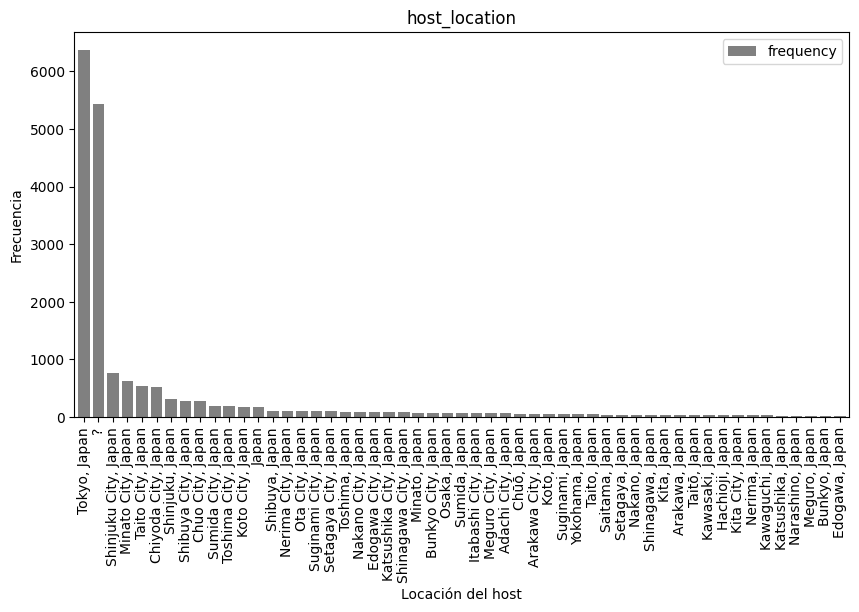

In [101]:
#Personalizamos grafico de barras
table18.plot(kind= 'bar', width=0.8, figsize=(10,5), color="gray")
plt.title('host_location')
plt.xlabel('Locación del host')
plt.ylabel('Frecuencia')

In [104]:
df['review_scores_checkin'] = df['review_scores_checkin'].astype('category')

In [105]:
table19= freq_tbl(df['review_scores_checkin'])
table19

,review_scores_checkin,frequency,percentage,cumulative_perc
0,5.00,5881,0.313888,0.313888
1,4.80,1285,0.068585,0.382472
2,4.88,480,0.025619,0.408091
3,4.86,438,0.023377,0.431469
4,4.83,436,0.023271,0.454740
...,...,...,...,...
68,4.35,20,0.001067,0.997171
69,4.37,17,0.000907,0.998079
70,4.32,14,0.000747,0.998826
71,4.28,13,0.000694,0.999520


In [106]:
#Elimina las columnas "percentage" y "cumulative_perc"
table19= table19.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table19= table19.set_index('review_scores_checkin')
table19

,frequency
review_scores_checkin,
5.00,5881
4.80,1285
4.88,480
4.86,438
4.83,436
...,...
4.35,20
4.37,17
4.32,14


In [107]:
#Obtengo un filtro de los valores más relevantes de la variables categórica seleccionada
table19= table19[table19['frequency']>248]
table19

,frequency
review_scores_checkin,
5.00,5881
4.80,1285
4.88,480
4.86,438
4.83,436
4.67,409
4.75,396
4.92,394
4.89,391


<Axes: ylabel='frequency'>

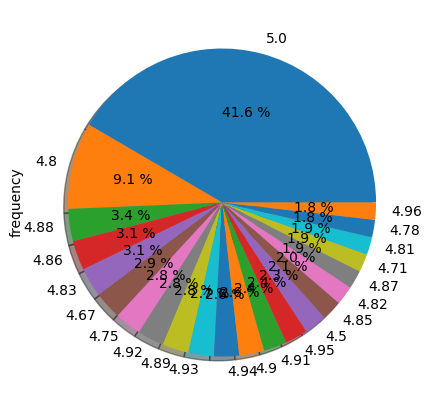

In [108]:
#Realizamos grafico de pastel
table19["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [109]:
table20= freq_tbl(df['review_scores_checkin'])
table20

,review_scores_checkin,frequency,percentage,cumulative_perc
0,5.00,5881,0.313888,0.313888
1,4.80,1285,0.068585,0.382472
2,4.88,480,0.025619,0.408091
3,4.86,438,0.023377,0.431469
4,4.83,436,0.023271,0.454740
...,...,...,...,...
68,4.35,20,0.001067,0.997171
69,4.37,17,0.000907,0.998079
70,4.32,14,0.000747,0.998826
71,4.28,13,0.000694,0.999520


In [110]:
table20= table20[table20['frequency']>250]
table20

,review_scores_checkin,frequency,percentage,cumulative_perc
0,5.00,5881,0.313888,0.313888
1,4.80,1285,0.068585,0.382472
2,4.88,480,0.025619,0.408091
3,4.86,438,0.023377,0.431469
4,4.83,436,0.023271,0.454740
5,4.67,409,0.021830,0.476569
6,4.75,396,0.021136,0.497705
7,4.92,394,0.021029,0.518734
8,4.89,391,0.020869,0.539603
9,4.93,378,0.020175,0.559778


In [111]:
#Elimina las columnas "percentage" y "cumulative_perc"
table20= table20.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table20= table20.set_index('review_scores_checkin')
table20

,frequency
review_scores_checkin,
5.00,5881
4.80,1285
4.88,480
4.86,438
4.83,436
4.67,409
4.75,396
4.92,394
4.89,391


Text(0, 0.5, 'Frecuencia')

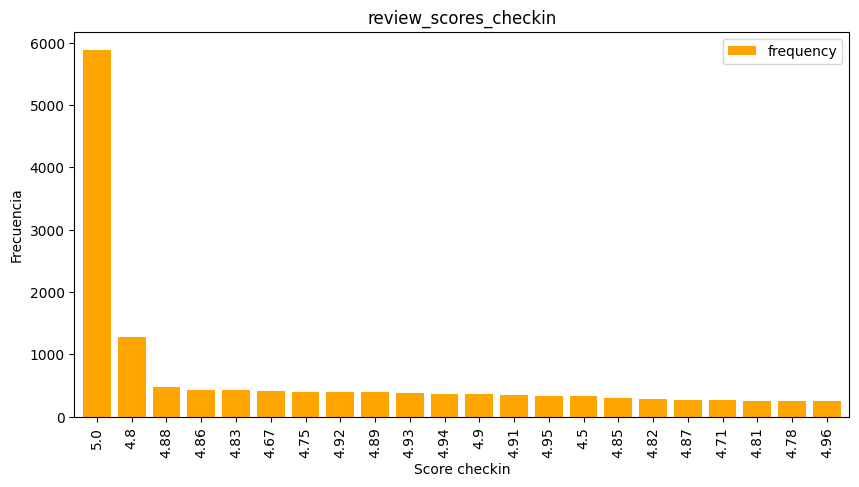

In [112]:
#Personalizamos grafico de barras
table20.plot(kind= 'bar', width=0.8, figsize=(10,5), color="orange")
plt.title('review_scores_checkin')
plt.xlabel('Score checkin')
plt.ylabel('Frecuencia')

In [114]:
df['accommodates'].info()
n=18736

<class 'pandas.core.series.Series'>
RangeIndex: 18736 entries, 0 to 18735
Series name: accommodates
Non-Null Count  Dtype  
--------------  -----  
18736 non-null  float64
dtypes: float64(1)
memory usage: 146.5 KB


In [115]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max= df['accommodates'].max()
Min= df['accommodates'].min()
Limites=[Min, Max]
Limites
#Calcular el Rango R
R= Max-Min
R
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni= 1+3.32*np.log10(n)
ni

15.185287234057915

In [116]:
#Calculamos el Ancho del Intervalo "i"
i= R/ni
i

0.7243853758214691

In [117]:
#Categorización de variables
intervalos=np.linspace(Min,Max,15)
intervalos

array([ 1.        ,  1.78571429,  2.57142857,  3.35714286,  4.14285714,
        4.92857143,  5.71428571,  6.5       ,  7.28571429,  8.07142857,
        8.85714286,  9.64285714, 10.42857143, 11.21428571, 12.        ])

In [118]:
#Creamos las categorías
categorias= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [119]:
#Finalmente creamos las categorías en la columna numérica
df['accommodates']= pd.cut(x=df['accommodates'],bins=intervalos,labels=categorias)
df['accommodates']

,accommodates
0,Categoria2
1,NaN
2,Categoria7
3,Categoria2
4,Categoria3
...,...
18731,Categoria7
18732,Categoria4
18733,Categoria3
18734,Categoria3


In [120]:
table21= freq_tbl(df['accommodates'])
table21

,accommodates,frequency,percentage,cumulative_perc
0,Categoria2,4792,0.255764,0.270551
1,Categoria4,3817,0.203725,0.486055
2,Categoria3,3263,0.174157,0.670280
3,Categoria7,1824,0.097353,0.773261
4,Categoria6,1339,0.071467,0.848860
5,Categorias9,957,0.051078,0.902891
6,Categorias12,525,0.028021,0.932532
7,Categoria8,517,0.027594,0.961721
8,Categorias14,285,0.015211,0.977812
9,Categorias11,271,0.014464,0.993112


<Axes: ylabel='frequency'>

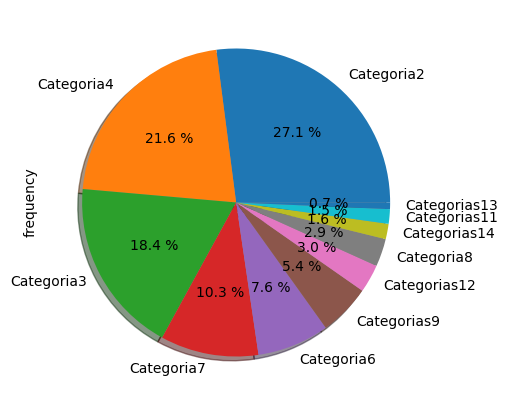

In [121]:
#Elimina las columnas "percentage" y "cumulative_perc"
table21= table21.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table21= table21.set_index('accommodates')
table21= table21[table21['frequency']>31]
#Realizamos grafico de pastel
table21["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [123]:
df['bedrooms'].info()
n=18736

<class 'pandas.core.series.Series'>
RangeIndex: 18736 entries, 0 to 18735
Series name: bedrooms
Non-Null Count  Dtype  
--------------  -----  
18736 non-null  float64
dtypes: float64(1)
memory usage: 146.5 KB


In [124]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max1= df['bedrooms'].max()
Min1= df['bedrooms'].min()
Limites1=[Min1, Max1]
Limites1
#Calcular el Rango R
R1= Max1-Min1
R1
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni1= 1+3.32*np.log10(n)
ni1

15.185287234057915

In [125]:
#Calculamos el Ancho del Intervalo "i"
i1= R1/ni1
i1

0.19755964795130976

In [126]:
#Categorización de variables
intervalos1=np.linspace(Min,Max,15)
intervalos1

array([ 1.        ,  1.78571429,  2.57142857,  3.35714286,  4.14285714,
        4.92857143,  5.71428571,  6.5       ,  7.28571429,  8.07142857,
        8.85714286,  9.64285714, 10.42857143, 11.21428571, 12.        ])

In [127]:
#Creamos las categorías
categorias1= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [128]:
#Finalmente creamos las categorías en la columna numérica
df['bedrooms']= pd.cut(x=df['bedrooms'],bins=intervalos1,labels=categorias1)
df['bedrooms']

,bedrooms
0,NaN
1,NaN
2,Categoria2
3,NaN
4,NaN
...,...
18731,Categoria2
18732,Categoria2
18733,NaN
18734,NaN


In [129]:
table22= freq_tbl(df['bedrooms'])
table22

,bedrooms,frequency,percentage,cumulative_perc
0,Categoria2,2913,0.155476,0.544079
1,Categoria3,1365,0.072854,0.799029
2,Categoria1,1076,0.057430,1.000000
3,Categoria4,0,0.000000,1.000000
4,Categoria5,0,0.000000,1.000000
5,Categoria6,0,0.000000,1.000000
6,Categoria7,0,0.000000,1.000000
7,Categoria8,0,0.000000,1.000000
8,Categorias9,0,0.000000,1.000000
9,Categorias10,0,0.000000,1.000000


Text(0, 0.5, 'Frecuencia')

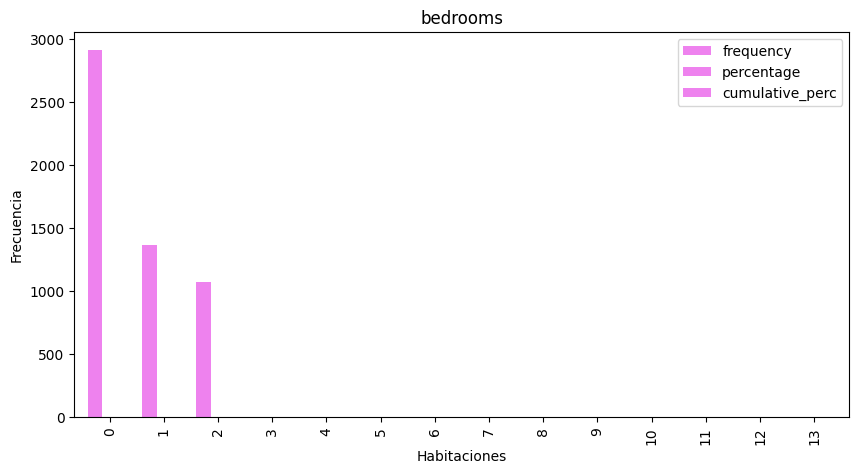

In [130]:
#Elimina las columnas "percentage" y "cumulative_perc"
#table22= table22.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
#table22= table22.set_index('bedrooms')
#table22= table22[table22['frequency']>0]
#Personalizamos grafico de barras
table22.plot(kind= 'bar', width=0.8, figsize=(10,5), color="violet")
plt.title('bedrooms')
plt.xlabel('Habitaciones')
plt.ylabel('Frecuencia')

In [132]:
df['minimum_nights'].info()
n=18736

<class 'pandas.core.series.Series'>
RangeIndex: 18736 entries, 0 to 18735
Series name: minimum_nights
Non-Null Count  Dtype  
--------------  -----  
18736 non-null  float64
dtypes: float64(1)
memory usage: 146.5 KB


In [133]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max2= df['minimum_nights'].max()
Min2= df['minimum_nights'].min()
Limites2=[Min2, Max2]
Limites2
#Calcular el Rango R
R2= Max2-Min2
R2
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni2= 1+3.32*np.log10(n)
ni2

15.185287234057915

In [134]:
#Calculamos el Ancho del Intervalo "i"
i2= R2/ni2
i2

0.13170643196753984

In [135]:
#Categorización de variables
intervalos2=np.linspace(Min2,Max2,15)
intervalos2

array([1.        , 1.14285714, 1.28571429, 1.42857143, 1.57142857,
       1.71428571, 1.85714286, 2.        , 2.14285714, 2.28571429,
       2.42857143, 2.57142857, 2.71428571, 2.85714286, 3.        ])

In [136]:
#Creamos las categorías
categorias2= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [137]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_nights']= pd.cut(x=df['minimum_nights'],bins=intervalos2,labels=categorias2)
df['minimum_nights']

,minimum_nights
0,Categorias14
1,Categorias14
2,Categorias14
3,Categoria7
4,Categoria7
...,...
18731,Categoria7
18732,NaN
18733,NaN
18734,NaN


In [138]:
table23= freq_tbl(df['minimum_nights'])
table23

,minimum_nights,frequency,percentage,cumulative_perc
0,Categoria7,5775,0.308230,0.59383
1,Categoria5,2249,0.120036,0.82509
2,Categorias14,1701,0.090788,1.00000
3,Categoria1,0,0.000000,1.00000
4,Categoria2,0,0.000000,1.00000
5,Categoria3,0,0.000000,1.00000
6,Categoria4,0,0.000000,1.00000
7,Categoria6,0,0.000000,1.00000
8,Categoria8,0,0.000000,1.00000
9,Categorias9,0,0.000000,1.00000


<Axes: ylabel='frequency'>

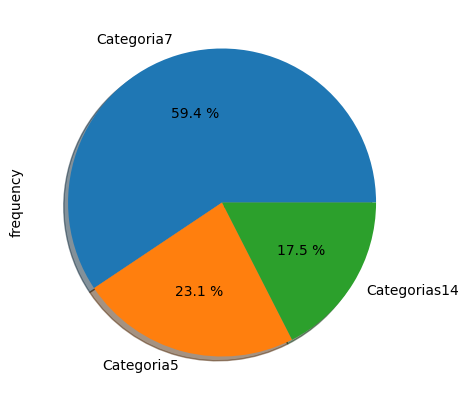

In [139]:
#Elimina las columnas "percentage" y "cumulative_perc"
table23= table23.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table23= table23.set_index('minimum_nights')
table23= table23[table23['frequency']>180]
#Realizamos grafico de pastel
table23["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [140]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max3= df['maximum_nights'].max()
Min3= df['maximum_nights'].min()
Limites3=[Min3, Max3]
Limites3
#Calcular el Rango R
R3= Max3-Min3
R3
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni3= 1+3.32*np.log10(n)
ni3

15.185287234057915

In [141]:
#Calculamos el Ancho del Intervalo "i"
i3= R3/ni3
i3

32.86075477590119

In [142]:
#Categorización de variables
intervalos3=np.linspace(Min3,Max3,15)
intervalos3

array([  1.        ,  36.64285714,  72.28571429, 107.92857143,
       143.57142857, 179.21428571, 214.85714286, 250.5       ,
       286.14285714, 321.78571429, 357.42857143, 393.07142857,
       428.71428571, 464.35714286, 500.        ])

In [143]:
#Creamos las categorías
categorias3= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [144]:
#Finalmente creamos las categorías en la columna numérica
df['maximum_nights']= pd.cut(x=df['maximum_nights'],bins=intervalos3,labels=categorias3)
df['maximum_nights']

,maximum_nights
0,Categoria8
1,Categoria1
2,Categoria8
3,Categoria1
4,Categoria2
...,...
18731,Categorias11
18732,Categorias11
18733,Categorias11
18734,Categorias11


In [145]:
table24= freq_tbl(df['maximum_nights'])
table24

,maximum_nights,frequency,percentage,cumulative_perc
0,Categorias11,10473,0.558977,0.559186
1,Categoria8,2672,0.142613,0.701853
2,Categoria1,2085,0.111283,0.813177
3,Categoria3,1209,0.064528,0.877730
4,Categoria6,1165,0.062180,0.939933
5,Categoria2,867,0.046275,0.986225
6,Categoria4,168,0.008967,0.995195
7,Categorias9,35,0.001868,0.997063
8,Categoria5,26,0.001388,0.998452
9,Categoria7,21,0.001121,0.999573


Text(0, 0.5, 'Frecuencia')

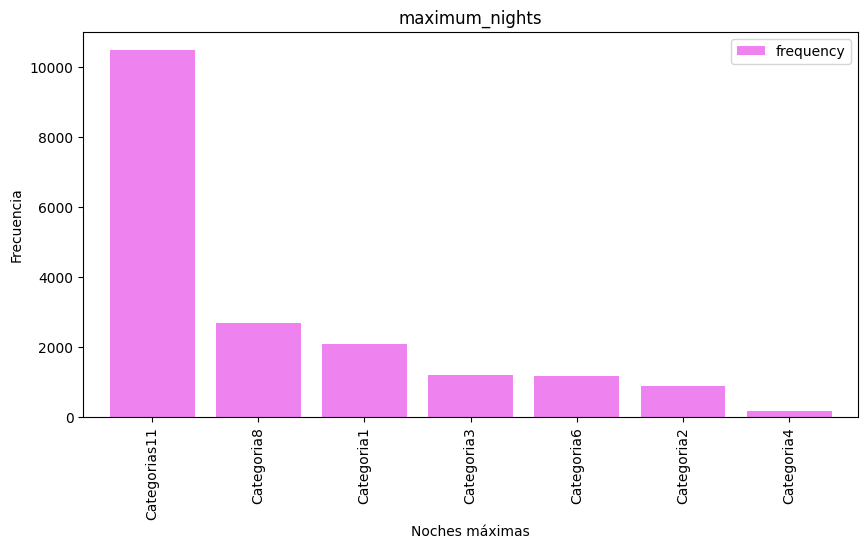

In [146]:
#Elimina las columnas "percentage" y "cumulative_perc"
table24= table24.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table24= table24.set_index('maximum_nights')
table24= table24[table24['frequency']>164]
#Personalizamos grafico de barras
table24.plot(kind= 'bar', width=0.8, figsize=(10,5), color="violet")
plt.title('maximum_nights')
plt.xlabel('Noches máximas')
plt.ylabel('Frecuencia')

In [147]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max4= df['minimum_minimum_nights'].max()
Min4= df['minimum_minimum_nights'].min()
Limites4=[Min4, Max4]
Limites4
#Calcular el Rango R
R4= Max4-Min4
R4
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni4= 1+3.32*np.log10(n)
ni4

15.185287234057915

In [148]:
#Calculamos el Ancho del Intervalo "i"
i4= R4/ni4
i4

0.13170643196753984

In [149]:
#Categorización de variables
intervalos4=np.linspace(Min4,Max4,15)
intervalos4

array([1.        , 1.14285714, 1.28571429, 1.42857143, 1.57142857,
       1.71428571, 1.85714286, 2.        , 2.14285714, 2.28571429,
       2.42857143, 2.57142857, 2.71428571, 2.85714286, 3.        ])

In [150]:
#Creamos las categorías
categorias4= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [151]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_minimum_nights']= pd.cut(x=df['minimum_minimum_nights'],bins=intervalos4,labels=categorias4)
df['minimum_minimum_nights']

,minimum_minimum_nights
0,Categorias14
1,Categorias14
2,NaN
3,Categoria7
4,Categoria7
...,...
18731,Categoria7
18732,NaN
18733,NaN
18734,NaN


In [152]:
table25= freq_tbl(df['minimum_minimum_nights'])
table25

,minimum_minimum_nights,frequency,percentage,cumulative_perc
0,Categoria7,4619,0.246531,0.614065
1,Categoria3,1868,0.099701,0.862404
2,Categorias14,1035,0.055241,1.000000
3,Categoria1,0,0.000000,1.000000
4,Categoria2,0,0.000000,1.000000
5,Categoria4,0,0.000000,1.000000
6,Categoria5,0,0.000000,1.000000
7,Categoria6,0,0.000000,1.000000
8,Categoria8,0,0.000000,1.000000
9,Categorias9,0,0.000000,1.000000


<Axes: ylabel='frequency'>

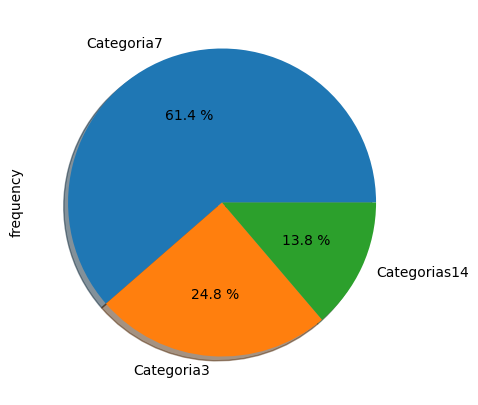

In [153]:
#Elimina las columnas "percentage" y "cumulative_perc"
table25= table25.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table25= table25.set_index('minimum_minimum_nights')
table25= table25[table25['frequency']>180]
#Realizamos grafico de pastel
table25["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [154]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max5= df['maximum_minimum_nights'].max()
Min5= df['maximum_minimum_nights'].min()
Limites5=[Min5, Max5]
Limites5
#Calcular el Rango R
R5= Max5-Min5
R5
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni5= 1+3.32*np.log10(n)
ni5

15.185287234057915

In [155]:
#Calculamos el Ancho del Intervalo "i"
i5= R5/ni5
i5

0.3292660799188496

In [156]:
#Categorización de variables
intervalos5=np.linspace(Min5,Max5,15)
intervalos5

array([1.        , 1.35714286, 1.71428571, 2.07142857, 2.42857143,
       2.78571429, 3.14285714, 3.5       , 3.85714286, 4.21428571,
       4.57142857, 4.92857143, 5.28571429, 5.64285714, 6.        ])

In [157]:
#Creamos las categorías
categorias5= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [158]:
#Finalmente creamos las categorías en la columna numérica
df['maximum_minimum_nights']= pd.cut(x=df['maximum_minimum_nights'],bins=intervalos5,labels=categorias5)
df['maximum_minimum_nights']

,maximum_minimum_nights
0,Categoria6
1,Categoria6
2,Categoria3
3,Categoria3
4,Categoria3
...,...
18731,Categorias12
18732,NaN
18733,NaN
18734,NaN


In [159]:
table26= freq_tbl(df['maximum_minimum_nights'])
table26

,maximum_minimum_nights,frequency,percentage,cumulative_perc
0,Categoria3,8042,0.429227,0.691369
1,Categoria6,2105,0.112351,0.872335
2,Categorias9,708,0.037788,0.933202
3,Categorias12,666,0.035547,0.990457
4,Categorias14,111,0.005924,1.000000
5,Categoria1,0,0.000000,1.000000
6,Categoria2,0,0.000000,1.000000
7,Categoria4,0,0.000000,1.000000
8,Categoria5,0,0.000000,1.000000
9,Categoria7,0,0.000000,1.000000


Text(0, 0.5, 'Frecuencia')

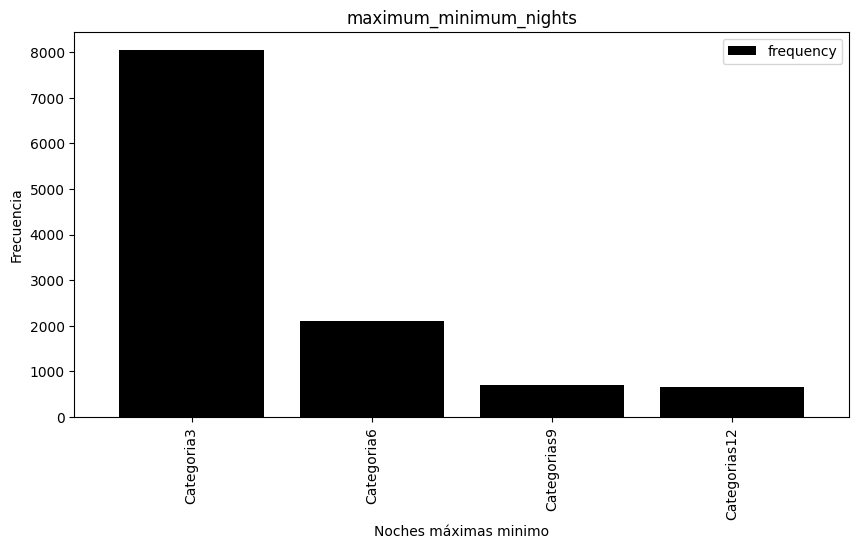

In [160]:
#Elimina las columnas "percentage" y "cumulative_perc"
table26= table26.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table26= table26.set_index('maximum_minimum_nights')
table26= table26[table26['frequency']>232]
#Personalizamos grafico de barras
table26.plot(kind= 'bar', width=0.8, figsize=(10,5), color="black")
plt.title('maximum_minimum_nights')
plt.xlabel('Noches máximas minimo')
plt.ylabel('Frecuencia')

In [161]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max6= df['minimum_maximum_nights'].max()
Min6= df['minimum_maximum_nights'].min()
Limites6=[Min6, Max6]
Limites6
#Calcular el Rango R
R6= Max6-Min6
R6
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni6= 1+3.32*np.log10(n)
ni6

15.185287234057915

In [162]:
#Calculamos el Ancho del Intervalo "i"
i6= R6/ni6
i6

74.01901476575739

In [163]:
#Categorización de variables
intervalos6=np.linspace(Min6,Max6,15)
intervalos6

array([1.00000000e+00, 8.12857143e+01, 1.61571429e+02, 2.41857143e+02,
       3.22142857e+02, 4.02428571e+02, 4.82714286e+02, 5.63000000e+02,
       6.43285714e+02, 7.23571429e+02, 8.03857143e+02, 8.84142857e+02,
       9.64428571e+02, 1.04471429e+03, 1.12500000e+03])

In [164]:
#Creamos las categorías
categorias6= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [165]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_maximum_nights']= pd.cut(x=df['minimum_maximum_nights'],bins=intervalos6,labels=categorias6)
df['minimum_maximum_nights']

,minimum_maximum_nights
0,Categorias14
1,Categoria1
2,Categoria5
3,Categoria1
4,Categorias14
...,...
18731,Categoria5
18732,Categoria5
18733,Categoria5
18734,Categoria5


In [166]:
table27= freq_tbl(df['minimum_maximum_nights'])
table27

,minimum_maximum_nights,frequency,percentage,cumulative_perc
0,Categoria5,8536,0.455594,0.456568
1,Categorias14,5661,0.302146,0.759360
2,Categoria1,2478,0.132259,0.891902
3,Categoria2,930,0.049637,0.941645
4,Categoria3,837,0.044673,0.986414
5,Categorias10,206,0.010995,0.997433
6,Categoria7,21,0.001121,0.998556
7,Categorias13,14,0.000747,0.999305
8,Categoria4,11,0.000587,0.999893
9,Categoria6,1,0.000053,0.999947


<Axes: ylabel='frequency'>

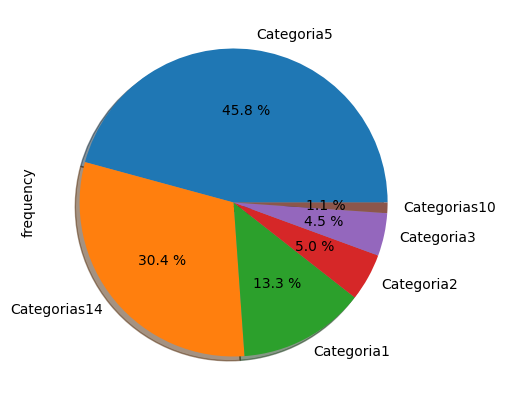

In [167]:
#Elimina las columnas "percentage" y "cumulative_perc"
table27= table27.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table27= table27.set_index('minimum_maximum_nights')
table27= table27[table27['frequency']>180]
#Realizamos grafico de pastel
table27["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [168]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max7= df['maximum_maximum_nights'].max()
Min7= df['maximum_maximum_nights'].min()
Limites7=[Min7, Max7]
Limites7
#Calcular el Rango R
R7= Max7-Min7
R7
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni7= 1+3.32*np.log10(n)
ni7

15.185287234057915

In [169]:
#Calculamos el Ancho del Intervalo "i"
i7= R7/ni7
i7

74.01901476575739

In [170]:
#Categorización de variables
intervalos7=np.linspace(Min7,Max7,15)
intervalos7

array([1.00000000e+00, 8.12857143e+01, 1.61571429e+02, 2.41857143e+02,
       3.22142857e+02, 4.02428571e+02, 4.82714286e+02, 5.63000000e+02,
       6.43285714e+02, 7.23571429e+02, 8.03857143e+02, 8.84142857e+02,
       9.64428571e+02, 1.04471429e+03, 1.12500000e+03])

In [171]:
#Creamos las categorías
categorias7= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [172]:
#Finalmente creamos las categorías en la columna numérica
df['maximum_maximum_nights']= pd.cut(x=df['maximum_maximum_nights'],bins=intervalos7,labels=categorias7)
df['maximum_maximum_nights']

,maximum_maximum_nights
0,Categorias14
1,Categoria1
2,Categorias14
3,Categoria1
4,Categorias14
...,...
18731,Categoria5
18732,Categoria5
18733,Categoria5
18734,Categoria5


In [173]:
table28= freq_tbl(df['maximum_maximum_nights'])
table28

,maximum_maximum_nights,frequency,percentage,cumulative_perc
0,Categoria5,8550,0.456341,0.456438
1,Categorias14,6419,0.342602,0.799114
2,Categoria1,1918,0.102370,0.901505
3,Categoria3,804,0.042912,0.944427
4,Categoria2,787,0.042005,0.986440
5,Categorias10,206,0.010995,0.997438
6,Categoria8,22,0.001174,0.998612
7,Categorias13,14,0.000747,0.999359
8,Categoria4,9,0.000480,0.999840
9,Categorias12,2,0.000107,0.999947


Text(0, 0.5, 'Frecuencia')

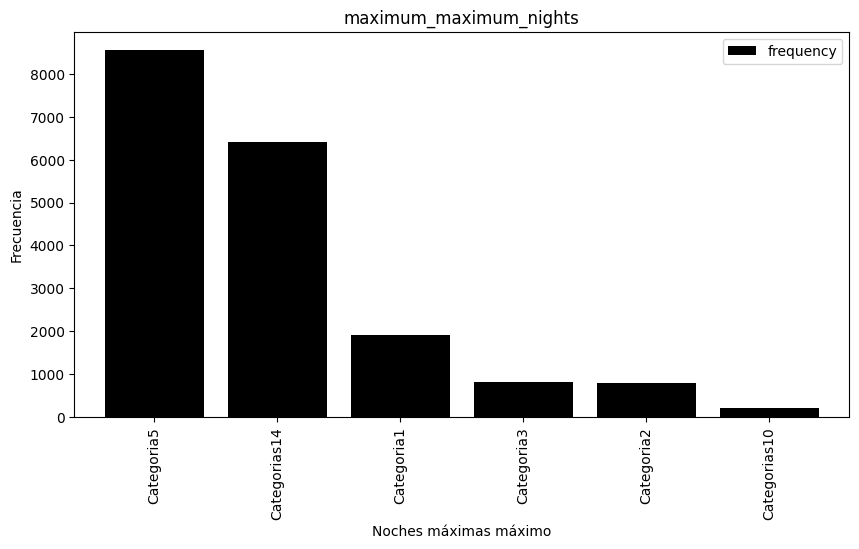

In [174]:
#Elimina las columnas "percentage" y "cumulative_perc"
table28= table28.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table28= table28.set_index('maximum_maximum_nights')
table28= table28[table28['frequency']>201]
#Personalizamos grafico de barras
table28.plot(kind= 'bar', width=0.8, figsize=(10,5), color="black")
plt.title('maximum_maximum_nights')
plt.xlabel('Noches máximas máximo')
plt.ylabel('Frecuencia')

In [175]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max8= df['minimum_nights_avg_ntm'].max()
Min8= df['minimum_nights_avg_ntm'].min()
Limites8=[Min8, Max8]
Limites8
#Calcular el Rango R
R8= Max8-Min8
R8
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni8= 1+3.32*np.log10(n)
ni8

15.185287234057915

In [176]:
#Calculamos el Ancho del Intervalo "i"
i8= R8/ni8
i8

0.3292660799188496

In [177]:
#Categorización de variables
intervalos8=np.linspace(Min8,Max8,15)
intervalos8

array([1.        , 1.35714286, 1.71428571, 2.07142857, 2.42857143,
       2.78571429, 3.14285714, 3.5       , 3.85714286, 4.21428571,
       4.57142857, 4.92857143, 5.28571429, 5.64285714, 6.        ])

In [178]:
#Creamos las categorías
categorias8= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [179]:
#Finalmente creamos las categorías en la columna numérica
df['minimum_nights_avg_ntm']= pd.cut(x=df['minimum_nights_avg_ntm'],bins=intervalos8,labels=categorias8)
df['minimum_nights_avg_ntm']

,minimum_nights_avg_ntm
0,Categoria6
1,Categoria6
2,Categorias9
3,Categoria3
4,Categoria3
...,...
18731,Categoria4
18732,NaN
18733,NaN
18734,NaN


In [180]:
table29= freq_tbl(df['minimum_nights_avg_ntm'])
table29

,minimum_nights_avg_ntm,frequency,percentage,cumulative_perc
0,Categoria3,6922,0.369449,0.601599
1,Categoria6,1655,0.088333,0.745437
2,Categoria4,607,0.032398,0.798192
3,Categoria2,586,0.031277,0.849122
4,Categoria1,412,0.021990,0.884930
5,Categorias9,397,0.021189,0.919433
6,Categoria5,255,0.013610,0.941596
7,Categorias12,153,0.008166,0.954893
8,Categorias11,113,0.006031,0.964714
9,Categoria7,109,0.005818,0.974187


<Axes: ylabel='frequency'>

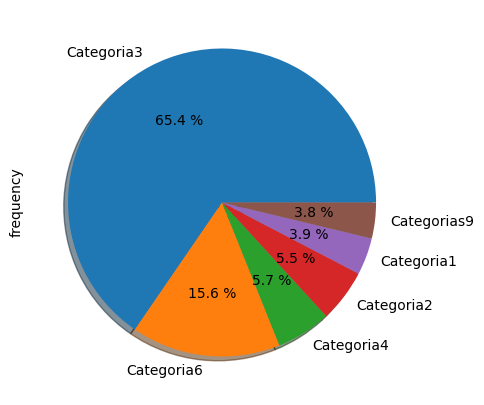

In [181]:
#Elimina las columnas "percentage" y "cumulative_perc"
table29= table29.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table29= table29.set_index('minimum_nights_avg_ntm')
table29= table29[table29['frequency']>294]
#Realizamos grafico de pastel
table29["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [182]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max9= df['availability_30'].max()
Min9= df['availability_30'].min()
Limites9=[Min9, Max9]
Limites9
#Calcular el Rango R
R9= Max9-Min9
R9
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni9= 1+3.32*np.log10(n)
ni9

15.185287234057915

In [183]:
#Calculamos el Ancho del Intervalo "i"
i9= R9/ni9
i9

1.580477183610478

In [184]:
#Categorización de variables
intervalos9=np.linspace(Min9,Max9,15)
intervalos9

array([ 0.        ,  1.71428571,  3.42857143,  5.14285714,  6.85714286,
        8.57142857, 10.28571429, 12.        , 13.71428571, 15.42857143,
       17.14285714, 18.85714286, 20.57142857, 22.28571429, 24.        ])

In [185]:
#Creamos las categorías
categorias9= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [186]:
#Finalmente creamos las categorías en la columna numérica
df['availability_30']= pd.cut(x=df['availability_30'],bins=intervalos9,labels=categorias9)
df['availability_30']

,availability_30
0,Categorias9
1,Categoria3
2,Categoria1
3,Categoria7
4,Categoria5
...,...
18731,Categoria5
18732,Categoria4
18733,Categorias10
18734,Categorias13


In [187]:
table30= freq_tbl(df['availability_30'])
table30

,availability_30,frequency,percentage,cumulative_perc
0,Categoria2,2662,0.142079,0.172354
1,Categoria3,2315,0.123559,0.322240
2,Categoria4,2111,0.112671,0.458919
3,Categoria5,1720,0.091802,0.570282
4,Categoria1,1294,0.069065,0.654063
5,Categoria6,1278,0.068211,0.736808
6,Categoria7,1002,0.053480,0.801683
7,Categorias9,663,0.035386,0.844610
8,Categorias10,571,0.030476,0.881580
9,Categoria8,434,0.023164,0.909680


Text(0, 0.5, 'Frecuencia')

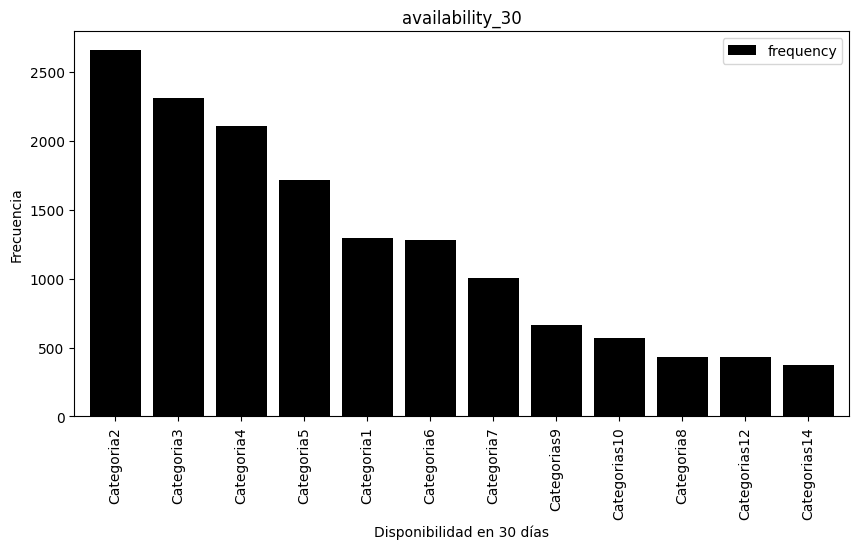

In [188]:
#Elimina las columnas "percentage" y "cumulative_perc"
table30= table30.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table30= table30.set_index('availability_30')
table30= table30[table30['frequency']>353]
#Personalizamos grafico de barras
table30.plot(kind= 'bar', width=0.8, figsize=(10,5), color="black")
plt.title('availability_30')
plt.xlabel('Disponibilidad en 30 días')
plt.ylabel('Frecuencia')

In [189]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max10= df['availability_60'].max()
Min10= df['availability_60'].min()
Limites10=[Min10, Max10]
Limites10
#Calcular el Rango R
R10= Max10-Min10
R10
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni10= 1+3.32*np.log10(n)
ni10

15.185287234057915

In [190]:
#Calculamos el Ancho del Intervalo "i"
i10= R10/ni10
i10

3.951192959026195

In [191]:
#Categorización de variables
intervalos10=np.linspace(Min10,Max10,15)
intervalos10

array([ 0.        ,  4.28571429,  8.57142857, 12.85714286, 17.14285714,
       21.42857143, 25.71428571, 30.        , 34.28571429, 38.57142857,
       42.85714286, 47.14285714, 51.42857143, 55.71428571, 60.        ])

In [192]:
#Creamos las categorías
categorias10= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [193]:
#Finalmente creamos las categorías en la columna numérica
df['availability_60']= pd.cut(x=df['availability_60'],bins=intervalos10,labels=categorias10)
df['availability_60']

,availability_60
0,Categoria7
1,Categoria3
2,Categoria2
3,Categoria4
4,Categoria7
...,...
18731,Categoria4
18732,Categorias14
18733,Categorias10
18734,Categorias11


In [194]:
table31= freq_tbl(df['availability_60'])
table31

,availability_60,frequency,percentage,cumulative_perc
0,Categoria4,2108,0.112511,0.125543
1,Categoria2,1882,0.100448,0.237627
2,Categoria3,1832,0.097780,0.346733
3,Categoria7,1516,0.080914,0.437020
4,Categoria1,1499,0.080006,0.526294
5,Categoria5,1456,0.077711,0.613007
6,Categoria6,1335,0.071253,0.692514
7,Categoria8,965,0.051505,0.749985
8,Categorias9,870,0.046435,0.801799
9,Categorias11,836,0.044620,0.851587


<Axes: ylabel='frequency'>

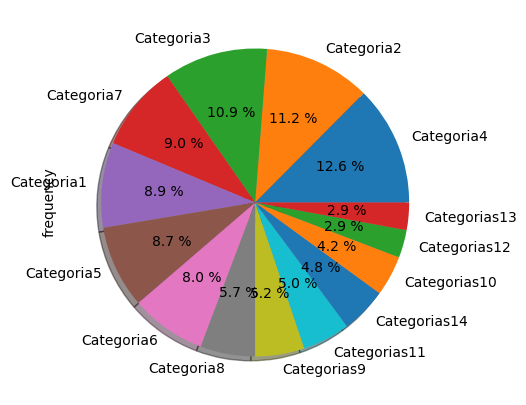

In [195]:
#Elimina las columnas "percentage" y "cumulative_perc"
table31= table31.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table31= table31.set_index('availability_60')
table31= table31[table31['frequency']>334]
#Realizamos grafico de pastel
table31["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")

In [196]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max11= df['availability_90'].max()
Min11= df['availability_90'].min()
Limites11=[Min11, Max11]
Limites11
#Calcular el Rango R
R11= Max11-Min11
R11
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni11= 1+3.32*np.log10(n)
ni11

15.185287234057915

In [197]:
#Calculamos el Ancho del Intervalo "i"
i11= R11/ni11
i11

5.926789438539293

In [198]:
#Categorización de variables
intervalos11=np.linspace(Min11,Max11,15)
intervalos11

array([ 0.        ,  6.42857143, 12.85714286, 19.28571429, 25.71428571,
       32.14285714, 38.57142857, 45.        , 51.42857143, 57.85714286,
       64.28571429, 70.71428571, 77.14285714, 83.57142857, 90.        ])

In [199]:
#Creamos las categorías
categorias11= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [200]:
#Finalmente creamos las categorías en la columna numérica
df['availability_90']= pd.cut(x=df['availability_90'],bins=intervalos11,labels=categorias11)
df['availability_90']

,availability_90
0,Categoria7
1,Categoria4
2,Categoria3
3,Categoria7
4,Categoria8
...,...
18731,Categoria6
18732,Categorias14
18733,Categorias11
18734,Categorias12


In [201]:
table32= freq_tbl(df['availability_90'])
table32

,availability_90,frequency,percentage,cumulative_perc
0,Categoria5,1728,0.092229,0.100500
1,Categoria7,1668,0.089026,0.197511
2,Categorias9,1445,0.077124,0.281552
3,Categorias10,1410,0.075256,0.363557
4,Categoria6,1400,0.074722,0.444981
5,Categoria8,1392,0.074295,0.525939
6,Categoria3,1386,0.073975,0.606549
7,Categoria4,1360,0.072588,0.685646
8,Categorias12,1055,0.056309,0.747005
9,Categorias11,997,0.053213,0.804990


Text(0, 0.5, 'Frecuencia')

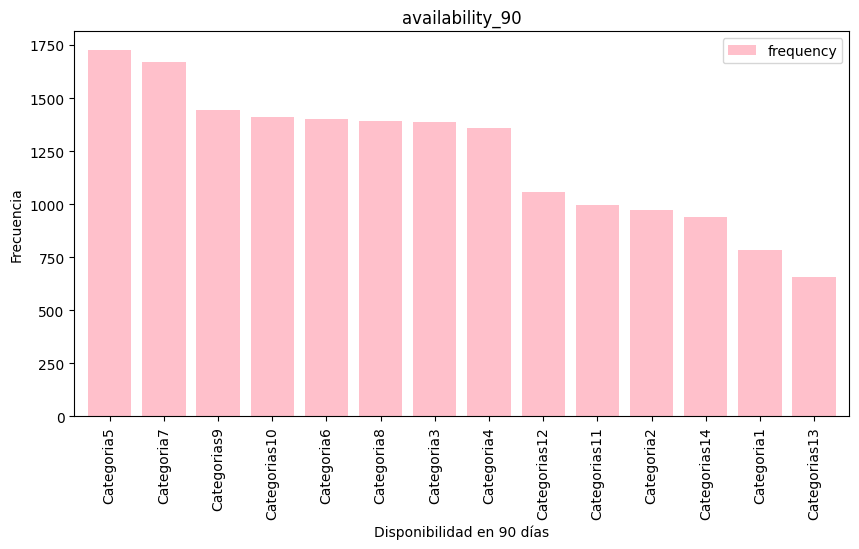

In [202]:
#Elimina las columnas "percentage" y "cumulative_perc"
table32= table32.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table32= table32.set_index('availability_90')
table32= table32[table32['frequency']>357]
#Personalizamos grafico de barras
table32.plot(kind= 'bar', width=0.8, figsize=(10,5), color="pink")
plt.title('availability_90')
plt.xlabel('Disponibilidad en 90 días')
plt.ylabel('Frecuencia')

In [203]:
#Obtenemos el límite superior e inferior de la columna objetivo
Max12= df['number_of_reviews_ltm'].max()
Min12= df['number_of_reviews_ltm'].min()
Limites12=[Min12, Max12]
Limites12
#Calcular el Rango R
R12= Max12-Min12
R12
#Calculamos el número de intervalos de Clase "ni", aplicando la regla de Sturges
ni12= 1+3.32*np.log10(n)
ni12

15.185287234057915

In [204]:
#Calculamos el Ancho del Intervalo "i"
i12= R12/ni12
i12

3.2268075832047263

In [205]:
#Categorización de variables
intervalos12=np.linspace(Min12,Max12,15)
intervalos12

array([ 0. ,  3.5,  7. , 10.5, 14. , 17.5, 21. , 24.5, 28. , 31.5, 35. ,
       38.5, 42. , 45.5, 49. ])

In [206]:
#Creamos las categorías
categorias12= ["Categoria1","Categoria2","Categoria3","Categoria4","Categoria5","Categoria6","Categoria7","Categoria8","Categorias9","Categorias10","Categorias11","Categorias12","Categorias13","Categorias14"]

In [207]:
#Finalmente creamos las categorías en la columna numérica
df['number_of_reviews_ltm']= pd.cut(x=df['number_of_reviews_ltm'],bins=intervalos12,labels=categorias12)
df['number_of_reviews_ltm']

,number_of_reviews_ltm
0,Categoria2
1,Categoria3
2,Categorias10
3,Categoria4
4,Categoria8
...,...
18731,NaN
18732,NaN
18733,NaN
18734,NaN


In [208]:
table33= freq_tbl(df['number_of_reviews_ltm'])
table33

,number_of_reviews_ltm,frequency,percentage,cumulative_perc
0,Categoria1,2873,0.153341,0.183872
1,Categoria2,2542,0.135675,0.346560
2,Categoria4,2413,0.128789,0.500992
3,Categoria3,1542,0.082301,0.599680
4,Categoria6,1236,0.065969,0.678784
5,Categoria5,1095,0.058444,0.748864
6,Categoria8,840,0.044833,0.802624
7,Categoria7,797,0.042538,0.853632
8,Categorias9,566,0.030209,0.889856
9,Categorias10,541,0.028875,0.924480


<Axes: ylabel='frequency'>

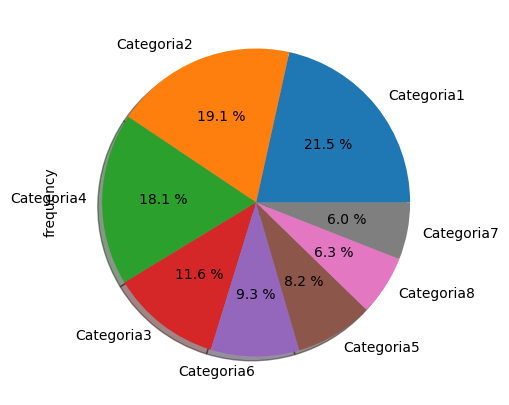

In [209]:
#Elimina las columnas "percentage" y "cumulative_perc"
table33= table33.drop(['percentage','cumulative_perc'], axis=1)
#Ajusto el indice de mi dataframe
table33= table33.set_index('number_of_reviews_ltm')
table33= table33[table33['frequency']>595]
#Realizamos grafico de pastel
table33["frequency"].plot(kind='pie', figsize=(10,5), shadow= True, autopct="%0.1f %%")